# Training

In [1]:
import os
import time
import numpy as np

import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import torch.backends.cudnn as cudnn
from torch.utils.data import DataLoader
torch.manual_seed(42)

from dataset import Agulhas4
from models.Pix2Pix import Discriminator, Generator, initialize_weights
from joint_transforms import Transform, Transform2 

from utils import LaplacianLoss, PrewittLoss

In [2]:
MODEL="17-PIX2PIX"
LEARNING_RATE_D=1.0E-4
LEARNING_RATE_G=2.0E-4
NUM_EPOCHS=500
INPUT_SIZE=256
BATCH_SIZE=4
NUM_WORKERS=0
LAMBDA_G=100
BETAS=[0.5, 0.999]
USE_CHECKPOINT = False

SNAPSHOT_DIR = os.path.join('outputs', MODEL, 'snapshots')
RESTORE_FROM = os.path.join('outputs', MODEL, 'snapshots')

try:
    os.makedirs(SNAPSHOT_DIR)
    print(SNAPSHOT_DIR)
except FileExistsError:
    pass

In [3]:
def save_checkpoint(model, optimizer, filename, learning_rate=None, epoch=None):

    print('Saving Checkpoint...')
    checkpoint = {
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'learning_rate': learning_rate,
        'epoch': epoch
    }
    torch.save(checkpoint, filename)

def load_checkpoint(checkpoint_file, model, optimizer=None, lr=None):
    
    checkpoint = torch.load(checkpoint_file)
    print('Number of Epochs: ', checkpoint['epoch'])
    print('Learning Rate: ', checkpoint['learning_rate'])
    model.load_state_dict(checkpoint['model_state_dict'])
    
    if optimizer is not None:
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
      
        if lr is not None:
            for param_group in optimizer.param_groups:
                param_group['lr'] = lr

        elif checkpoint['learning_rate'] is not None:
            for param_group in optimizer.param_groups:
                param_group['lr'] = checkpoint['learning_rate']

In [4]:
def save_examples3(x, y, y_fake, transform_params, counter, saving_path):
    import xarray as xr
    from matplotlib import figure
    import matplotlib
    matplotlib.use('Agg')
    
    fig = figure.Figure(figsize=(20, 7), constrained_layout=True)
    axes = fig.subplots(nrows= x.shape[0], ncols=5)
    
    for idx in range(x.shape[0]):
        
        image = (x[idx].detach().cpu().numpy() + 1) / 2
        
        target_it = (y[idx, 0, ...].detach().cpu().numpy() + 1) / 2
        target_bm = (y[idx, 1, ...].detach().cpu().numpy() + 1) / 2
        
        gen_target_it = (y_fake[idx, 0, ...].detach().cpu().numpy() + 1) / 2
            
        image = image * (transform_params['inputs'][1] - transform_params['inputs'][0]) + transform_params['inputs'][0]
        
        target_it = target_it * (transform_params['targets_it'][1] - transform_params['targets_it'][0]) + transform_params['targets_it'][0]
        target_bm = target_bm * (transform_params['targets_bm'][1] - transform_params['targets_bm'][0]) + transform_params['targets_bm'][0]
        
        gen_target_it = gen_target_it * (transform_params['targets_it'][1] - transform_params['targets_it'][0]) + transform_params['targets_it'][0]
        gen_target_bm = image - gen_target_it

        xr.DataArray(image.squeeze(), dims=['x', 'y']).plot(x="x", y="y", robust=True, yincrease=False, ax=axes[idx, 0])
        xr.DataArray(target_it.squeeze(), dims=['x', 'y']).plot(x="x", y="y", robust=True, yincrease=False, ax=axes[idx, 1])
        xr.DataArray(target_bm.squeeze(), dims=['x', 'y']).plot(x="x", y="y", robust=True, yincrease=False, ax=axes[idx, 3])
        xr.DataArray(gen_target_it.squeeze(), dims=['x', 'y']).plot(x="x", y="y", robust=True, yincrease=False, ax=axes[idx, 2])
        xr.DataArray(gen_target_bm.squeeze(), dims=['x', 'y']).plot(x="x", y="y", robust=True, yincrease=False, ax=axes[idx, 4])

    fig.savefig(f'{saving_path}/{counter}.png', format='png', bbox_inches='tight', pad_inches=0.1)
    del image, target_it, target_bm, gen_target_it, gen_target_bm

In [5]:
def val_loop(dataloader, transform_params, model, saving_path):

    model.eval()
    with torch.no_grad():
        for counter, (ssh, bm, it) in enumerate(dataloader, 1):

            # GPU deployment
            ssh = ssh.cuda()
            it = it.cuda()
            bm = bm.cuda()

            # Compute prediction and loss
            pred = model(ssh)
            y = torch.cat([it, bm], dim=1)

            save_examples3(ssh, y, pred, transform_params, counter, saving_path)
            
            if counter == 5:
                break

def psnr(original, reconstructed):
    
    # R is the maximum fluctuation in the input image data type. [-1, +1] -> 2.0
    mse = F.mse_loss(original, reconstructed)
    psnr = 20 * torch.log10(2.0 / torch.sqrt(mse))

    return psnr

In [6]:
def main():
    
    since = time.time()
    
    cudnn.enabled = True
    cudnn.benchmark = True
    
    print(f"{MODEL} is deployed on {torch.cuda.get_device_name(0)}")
    
    # Loading model
    discriminator = Discriminator(in_channels=1).cuda()
    generator = Generator(in_channels=1, features=64).cuda()
    
    initialize_weights(discriminator)
    initialize_weights(generator)

    # Dataloader
    joint_transforms = Transform()
    joint_transforms2 = Transform2()
    
    train_dataset = Agulhas4(split='train', joint_transform=joint_transforms)
    val_dataset = Agulhas4(split='val', joint_transform=joint_transforms2)

    train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    val_dataloader = DataLoader(val_dataset, batch_size=2, shuffle=True)

    # Initializing the loss function and optimizer
    optimizer_D = optim.Adam(discriminator.parameters(), lr=LEARNING_RATE_D, betas=tuple(BETAS))
    optimizer_G = optim.Adam(generator.parameters(), lr=LEARNING_RATE_G, betas=tuple(BETAS))
    
    scheduler_D = optim.lr_scheduler.StepLR(optimizer_D, step_size=100, gamma=0.5)
    scheduler_G = optim.lr_scheduler.StepLR(optimizer_G, step_size=100, gamma=0.5)
    

    bce_loss = nn.BCEWithLogitsLoss()    
    l1_loss = nn.L1Loss()
    
    if USE_CHECKPOINT:
        RESTORE_PTH = os.path.join('outputs', '11-PIX2PIX', 'snapshots', 'epoch-200')
        load_checkpoint(f'{RESTORE_PTH}/discriminator.pth.tar', discriminator, optimizer_D, LEARNING_RATE_D)
        load_checkpoint(f'{RESTORE_PTH}/generator.pth.tar', generator, optimizer_G, LEARNING_RATE_G)
    
    transform_params = train_dataset.transform_dict
    logger = {
        'loss_D': list(), 'loss_G': list(), 
        'loss_D1': list(), 'loss_D2': list(),
        'loss_G1': list(), 'loss_G2': list(),
        'psnr': list()
     }
    
    for epoch in range(1, NUM_EPOCHS + 1):
       
        generator.train()

        batch_loss_D = 0.0
        batch_loss_G = 0.0
        batch_psnr = 0.0
        
        batch_loss_D1 = 0.0
        batch_loss_D2 = 0.0
        
        batch_loss_G1 = 0.0
        batch_loss_G2 = 0.0
        
        for batch, (x, y) in enumerate(train_dataloader, 1):
            
            # GPU deployment
            x = x.to(torch.float).cuda()
            y = y.to(torch.float).cuda()

            # Training Discriminator            
            y_fake = generator(x)
            real_D = discriminator(x, y)
            fake_D = discriminator(x, y_fake.detach())
            # print(real_D, fake_D)

            # Compute Loss Function
            loss_real_D = bce_loss(real_D, torch.ones_like(real_D))
            loss_fake_D = bce_loss(fake_D, torch.zeros_like(fake_D))
            loss_D = (loss_real_D + loss_fake_D) / 2

            # Backpropagation
            optimizer_D.zero_grad()
            loss_D.backward()
            optimizer_D.step()

            # Training Generator
            fake_D = discriminator(x, y_fake)
            loss_fake_G = bce_loss(fake_D, torch.ones_like(fake_D))
            loss_G2 = l1_loss(y_fake, y) * LAMBDA_G
            loss_G = loss_fake_G + loss_G2

            # Backpropagation
            optimizer_G.zero_grad()
            loss_G.backward()
            optimizer_G.step()

            # Statistics
            batch_loss_D += loss_D.item()
            batch_loss_G += loss_G.item()
            
            batch_loss_D1 += loss_real_D.item()
            batch_loss_D2 += loss_fake_D.item()
            
            batch_loss_G1 += loss_fake_G.item()
            batch_loss_G2 += loss_G2.item()
            
            batch_psnr += psnr(y.detach(), y_fake.detach()).cpu().numpy()

        logger['loss_D'].append(batch_loss_D / len(train_dataloader))
        logger['loss_G'].append(batch_loss_G / len(train_dataloader))
        logger['psnr'].append(batch_psnr / len(train_dataloader))
        
        logger['loss_D1'].append(batch_loss_D1 / len(train_dataloader))
        logger['loss_D2'].append(batch_loss_D2 / len(train_dataloader))
        
        logger['loss_G1'].append(batch_loss_G1 / len(train_dataloader))
        logger['loss_G2'].append(batch_loss_G2 / len(train_dataloader))
        
        print(f"Epoch: {epoch}, D Loss: {logger['loss_D'][-1]:.5f}, G Loss: {logger['loss_G'][-1]:.5f}, PSNR: {logger['psnr'][-1]:.2f}")
        
        scheduler_D.step()
        scheduler_G.step()
        
        if epoch % 10 == 0:
            current_epoch_directory = os.path.join(SNAPSHOT_DIR, f'epoch-{epoch:003d}')

            try:
                os.makedirs(current_epoch_directory)
            except FileExistsError:
                pass

            val_loop(val_dataloader, transform_params, generator, current_epoch_directory)
        
        if epoch % 100 == 0:
            print('D LR', scheduler_D.get_last_lr(), 'G LR', scheduler_G.get_last_lr())
            save_checkpoint(discriminator, optimizer_D,  os.path.join(current_epoch_directory, 'discriminator.pth.tar'), scheduler_D.get_last_lr(), epoch)
            save_checkpoint(generator, optimizer_G,  os.path.join(current_epoch_directory, 'generator.pth.tar'), scheduler_G.get_last_lr(), epoch)
    
    with open(os.path.join(SNAPSHOT_DIR, "logger.npy"), mode = 'wb') as f:
        np.save(f, np.array(logger['loss_D']))
        np.save(f, np.array(logger['loss_G']))
        np.save(f, np.array(logger['psnr']))
        
        np.save(f, np.array(logger['loss_D1']))
        np.save(f, np.array(logger['loss_D2']))
        np.save(f, np.array(logger['loss_G1']))
        np.save(f, np.array(logger['loss_G2']))
    
    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')

In [ ]:
main()

17-PIX2PIX is deployed on Tesla T4
Epoch: 1, D Loss: 0.73496, G Loss: 7.26329, PSNR: 27.73
Epoch: 2, D Loss: 0.65982, G Loss: 5.86002, PSNR: 29.60


In [4]:
import xrft
import xarray as xr
from tqdm import tqdm
import matplotlib.pyplot as plt
from utils import plot_examples
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

%matplotlib inline

In [5]:
with open(os.path.join(RESTORE_FROM, 'logger.npy'), 'rb') as f:
    loss_D = np.load(f)
    loss_G = np.load(f)
    PSNRs = np.load(f)
    
    loss_G1 = np.load(f)   
    loss_G2 = np.load(f)   
    loss_D1 = np.load(f)   
    loss_D2 = np.load(f)   

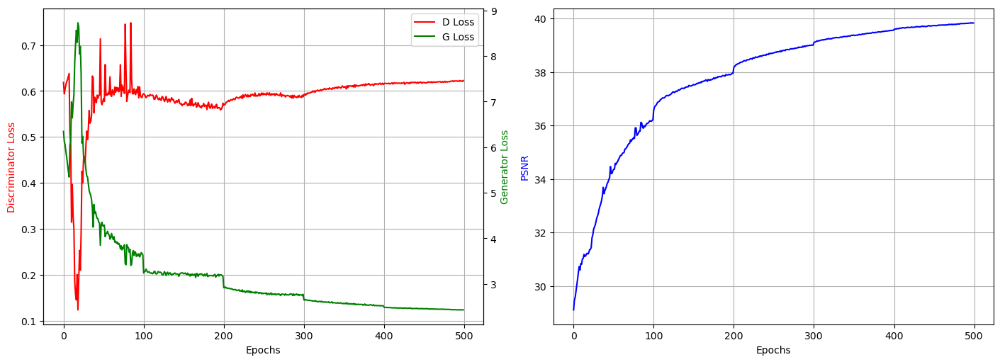

In [6]:
fig, (ax1, ax3) = plt.subplots(ncols=2, figsize=(14, 5), constrained_layout=True)

lns1 = ax1.plot(loss_D, 'r', label='D Loss')

ax2 = ax1.twinx()
lns2 = ax2.plot(loss_G, 'g', label='G Loss')

ax3.plot(PSNRs, 'b-')

ax1.set_xlabel('Epochs')
ax1.set_ylabel('Discriminator Loss', color='r')
ax2.set_ylabel('Generator Loss', color='g')

ax3.set_xlabel('Epochs')
ax3.set_ylabel('PSNR', color='b')

lns = lns1 + lns2
labs = [l.get_label() for l in lns]
ax1.legend(lns, labs, loc=1)

ax1.grid()
ax3.grid()
plt.show()

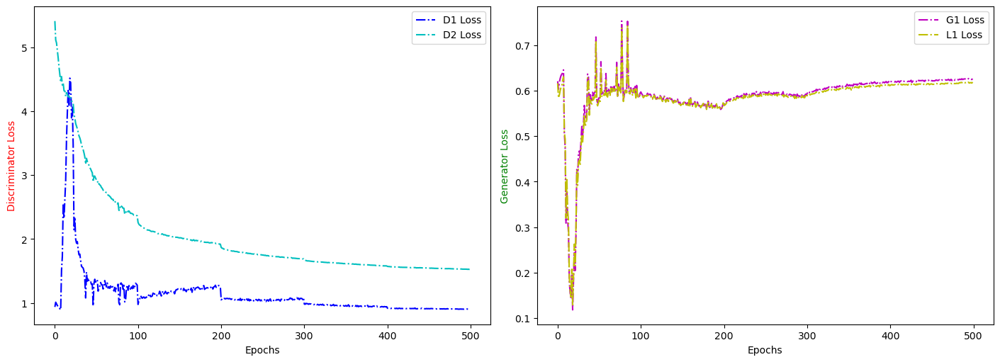

In [7]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(14, 5), constrained_layout=True)

lns2 = ax1.plot(loss_D1, 'b-.', label='D1 Loss')
lns3 = ax1.plot(loss_D2, 'c-.', label='D2 Loss')

lns5 = ax2.plot(loss_G1, 'm-.', label='G1 Loss')
lns6 = ax2.plot(loss_G2, 'y-.', label='L1 Loss')


ax1.set_xlabel('Epochs')
ax1.set_ylabel('Discriminator Loss', color='r')

ax2.set_xlabel('Epochs')
ax2.set_ylabel('Generator Loss', color='g')

ax1.legend(loc=1)
ax2.legend(loc=1)

plt.show()

In [7]:
# dataset = Agulhas3(split='val', joint_transform=None)
# dataloader = DataLoader(dataset, batch_size=1, shuffle=False, drop_last=False)

# cudnn.enabled = True
# cudnn.benchmark = True

model = Generator(in_channels=1, features=64).cuda()
load_checkpoint(f'{RESTORE_FROM}/epoch-{NUM_EPOCHS:003d}/generator.pth.tar', model)

Number of Epochs:  500
Learning Rate:  [6.25e-06]


In [9]:
SSHs = np.empty((0, 1, 256, 256))

ITs = np.empty((0, 1, 256, 256))
BMs = np.empty((0, 1, 256, 256))

GITs = np.empty((0, 1, 256, 256))

model.eval()
with torch.no_grad():
    
    loop = tqdm(dataloader, leave=True)
    for counter, (ssh, it, bm) in enumerate(loop, 1):

        # GPU deployment
        ssh = ssh.cuda()
        it = it.cuda()
        bm = bm.cuda()

        # Compute prediction and loss
        git = model(ssh)
        
        ssh_ = ssh.detach().cpu().numpy()
        
        bm_ = bm.detach().cpu().numpy()
        it_ = it.detach().cpu().numpy()
        
        git_ = git.detach().cpu().numpy()
        
        SSHs = np.concatenate((SSHs, ssh_), axis=0)
        
        ITs = np.concatenate((ITs, it_), axis=0)
        BMs = np.concatenate((BMs, bm_), axis=0)
        
        GITs = np.concatenate((GITs, git_) , axis=0)

print(SSHs.shape, BMs.shape, ITs.shape, GITs.shape)   

100%|██████████| 413/413 [01:17<00:00,  5.35it/s]

(413, 1, 256, 256) (413, 1, 256, 256) (413, 1, 256, 256) (413, 1, 256, 256)


In [11]:
SSHs = (SSHs + 1) / 2

BMs = (BMs + 1) / 2
ITs = (ITs + 1) / 2

GITs = (GITs + 1) / 2

SSHs = SSHs * (dataset.transform_dict['inputs'][1] - dataset.transform_dict['inputs'][0]) + dataset.transform_dict['inputs'][0]

BMs = BMs * (dataset.transform_dict['targets_bm'][1] - dataset.transform_dict['targets_bm'][0]) + dataset.transform_dict['targets_bm'][0]
ITs = ITs * (dataset.transform_dict['targets_it'][1] - dataset.transform_dict['targets_it'][0]) + dataset.transform_dict['targets_it'][0]

GITs = GITs * (dataset.transform_dict['targets_it'][1] - dataset.transform_dict['targets_it'][0]) + dataset.transform_dict['targets_it'][0]

DBMs = SSHs - GITs

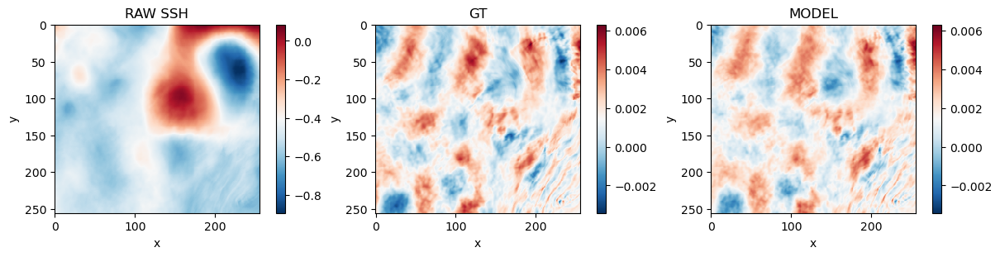

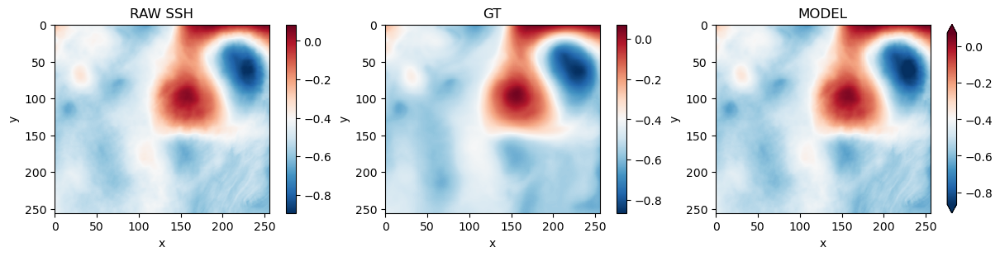

In [12]:
idx = 105
plot_examples(SSHs[idx], ITs[idx], GITs[idx])
plot_examples(SSHs[idx], BMs[idx], DBMs[idx])

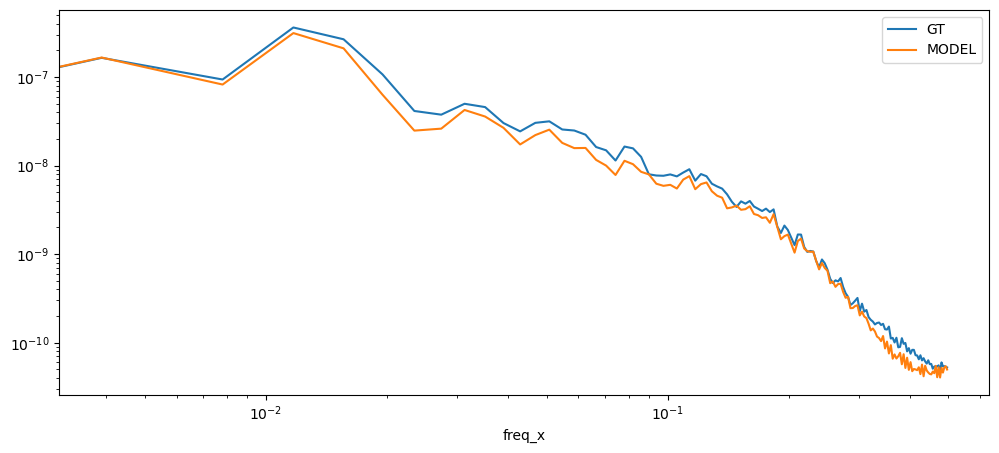

In [13]:
fig, ax = plt.subplots(figsize=(12, 5))

da_rw = xr.DataArray(SSHs[idx].squeeze(), dims=['x', 'y'])
da_gt = xr.DataArray(ITs[idx].squeeze(), dims=['x', 'y'])
da_gn = xr.DataArray(GITs[idx].squeeze(), dims=['x', 'y'])

ps_rw = xrft.power_spectrum(da_rw, 'x', window='hamming').rename('rw')
ps_gt = xrft.power_spectrum(da_gt, 'x', window='hamming').rename('gt')
ps_gn = xrft.power_spectrum(da_gn, 'x', window='hamming').rename('gn')

# (ps_rw * ps_rw.freq_x).mean('y').plot(label='RAW SSH', ax=ax)
(ps_gt * ps_gt.freq_x).mean('y').plot(label='GT', ax=ax)
(ps_gn * ps_gn.freq_x).mean('y').plot(label='MODEL', ax=ax)

ax.set_xscale('log')
ax.set_yscale('log')

plt.legend()
plt.show()

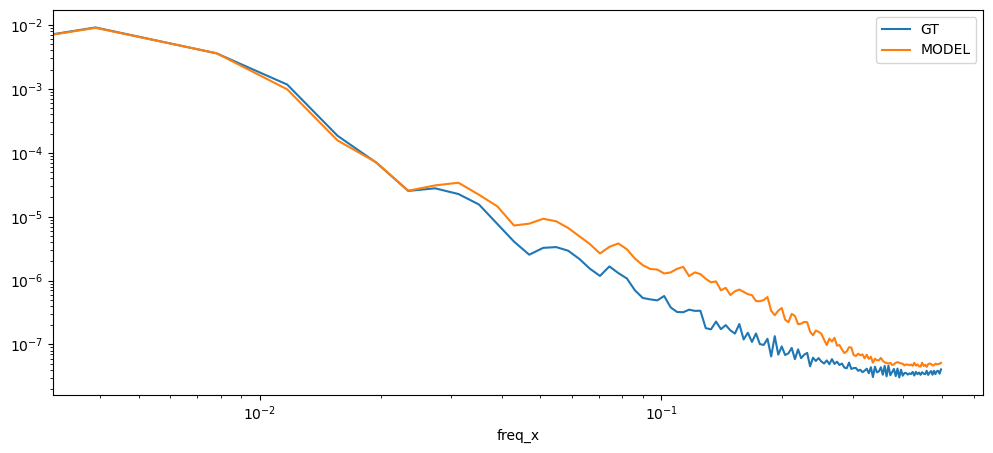

In [14]:
fig, ax = plt.subplots(figsize=(12, 5))

da_rw = xr.DataArray(SSHs[idx].squeeze(), dims=['x', 'y'])
da_gt = xr.DataArray(BMs[idx].squeeze(), dims=['x', 'y'])
da_gn = xr.DataArray(DBMs[idx].squeeze(), dims=['x', 'y'])

ps_rw = xrft.power_spectrum(da_rw, 'x', window='hamming').rename('rw')
ps_gt = xrft.power_spectrum(da_gt, 'x', window='hamming').rename('gt')
ps_gn = xrft.power_spectrum(da_gn, 'x', window='hamming').rename('gn')

# (ps_rw * ps_rw.freq_x).mean('y').plot(label='RAW SSH', ax=ax)
(ps_gt * ps_gt.freq_x).mean('y').plot(label='GT', ax=ax)
(ps_gn * ps_gn.freq_x).mean('y').plot(label='MODEL', ax=ax)

plt.xscale('log')
plt.yscale('log')

plt.legend()
plt.show()

In [32]:
da_sshs = xr.DataArray(SSHs.squeeze(), dims=['z', 'x', 'y'])
da_its = xr.DataArray(ITs.squeeze(), dims=['z', 'x', 'y'])
da_gits = xr.DataArray(GITs.squeeze(), dims=['z', 'x', 'y'])
da_bms = xr.DataArray(BMs.squeeze(), dims=['z', 'x', 'y'])
da_dbms = xr.DataArray(DBMs.squeeze(), dims=['z', 'x', 'y'])

ps_sshs = xrft.power_spectrum(da_sshs, 'x', window='hamming')
ps_its = xrft.power_spectrum(da_its, 'x', window='hamming')
ps_gits = xrft.power_spectrum(da_gits, 'x', window='hamming')
ps_bms = xrft.power_spectrum(da_bms, 'x', window='hamming')
ps_dbms = xrft.power_spectrum(da_dbms, 'x', window='hamming')

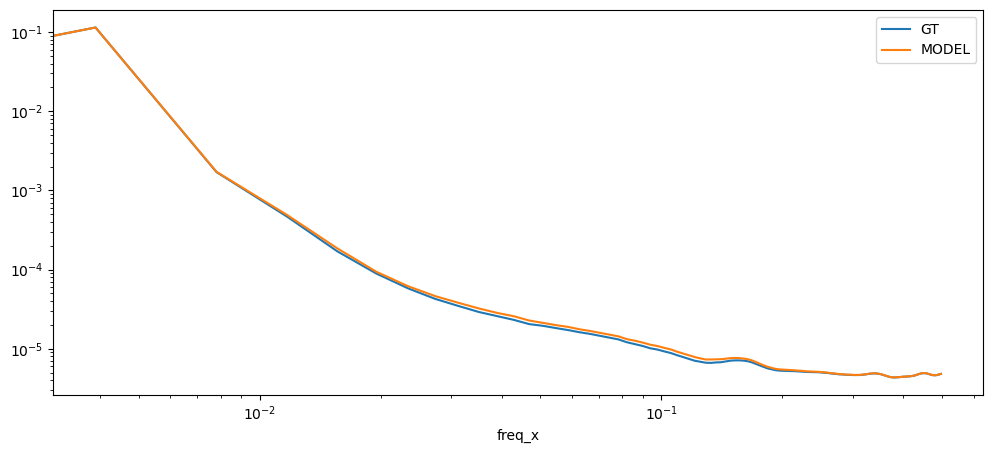

In [34]:
fig, ax = plt.subplots(figsize=(12, 5))

(ps_bms * ps_bms.freq_x).mean(['z', 'y']).plot(label='GT', ax=ax)
(ps_dbms * ps_dbms.freq_x).mean(['z', 'y']).plot(label='MODEL', ax=ax)

ax.set_xscale('log')
ax.set_yscale('log')

plt.legend()
plt.show()

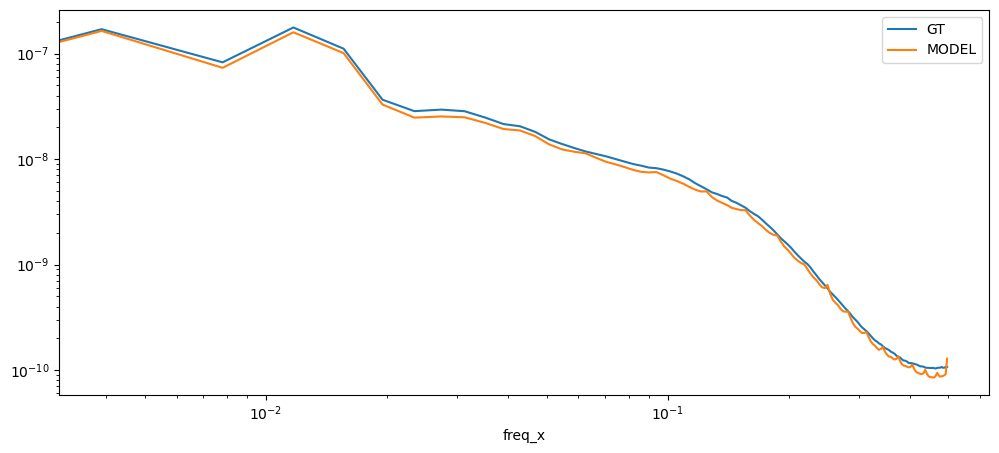

In [33]:
fig, ax = plt.subplots(figsize=(12, 5))

(ps_its * ps_its.freq_x).mean(['z', 'y']).plot(label='GT', ax=ax)
(ps_gits * ps_gits.freq_x).mean(['z', 'y']).plot(label='MODEL', ax=ax)

ax.set_xscale('log')
ax.set_yscale('log')

plt.legend()
plt.show()

## Test Set

In [8]:
import xarray as xr
import numpy as np
import dask.array as da
import matplotlib.pyplot as plt

In [9]:
PERSISTENT_BUCKET = 'gs://leap-persistent/dhruvbalwada'
unfiltered_link = PERSISTENT_BUCKET + '/ssh_reconstruction_project/unfiltered_data.zarr'
filtered_link = PERSISTENT_BUCKET+'/ssh_reconstruction_project/filtered_data.zarr'

In [10]:
da_unfiltered = xr.open_zarr(unfiltered_link)['ssh_unfiltered']
da_filtered = xr.open_zarr(filtered_link)['ssh_filtered']
da_it = da_unfiltered - da_filtered

In [11]:
rng = np.random.default_rng(2019)
arr = np.arange(70)
rng.shuffle(arr)

ssh = da_unfiltered[arr[49:56], 56:-56, 56:-56].chunk({'i':256, 'j':256}).fillna(0)
bm = da_filtered[arr[49:56], 56:-56, 56:-56].chunk({'i':256, 'j':256}).fillna(0)
it = da_it[arr[49:56], 56:-56, 56:-56].chunk({'i':256, 'j':256}).fillna(0)

In [12]:
ssh

<xarray.DataArray 'ssh_unfiltered' (time: 7, i: 2048, j: 2048)>
dask.array<where, shape=(7, 2048, 2048), dtype=float32, chunksize=(2, 256, 256), chunktype=numpy.ndarray>
Coordinates: (12/15)
    Depth    (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    RAC      (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    XC       (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    YC       (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    face     int64 ...
  * i        (i) int64 1136 1137 1138 1139 1140 ... 3179 3180 3181 3182 3183
    ...       ...
  * time     (time) timedelta64[ns] 14 days 18:00:00 ... 69 days 18:00:00
    x        (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    x0       (i) float64 dask.array<chunksize=(256,), meta=np.ndarray>
    y        (j, i) float32 dask.array<chunksize=(256, 256), meta=np.ndarray>
    y0       (j) float64 dask.array<chunksize=(256,), meta=np.ndarray>
    z0       float64 ...
Attributes:
    long_name:  Steric sea surface height
    units:      meters

In [13]:
transform_dict = {'inputs' : (-2.0309153, 1.098078), 
                 'targets_it': (-0.121434465, 0.12447834), 
                 'targets_bm': (-2.032202, 1.0936853)
                 }
def transformation(data, transform_parameters, inverse_transform=False):
           
    if inverse_transform:
        data = (data + 1) / 2
        data = data * (transform_parameters[1] - transform_parameters[0]) + transform_parameters[0]
        return data

    data = (data - transform_parameters[0]) / (transform_parameters[1] - transform_parameters[0])
    return (2 * data) - 1

def reshape_arr(arr):
    
    arr = arr.reshape(8, 256, 8, 256) # (8, 256, 8, 256)
    arr = arr.transpose(0, 2, 1, 3)   # (8, 8, 256, 256)
    arr = arr.reshape(-1, 1, 256, 256)   # (64, 1, 256, 256)
    
    return arr
    

In [14]:
def inference(model, dataset):
    
    dataset_tensor = torch.tensor(dataset, dtype=torch.float32)
    dataset_tensor = torch.unsqueeze(dataset_tensor, 1)
    gens = np.empty((0, 64, 256, 256))
    
    model = model.cuda()
    model.eval()
    with torch.no_grad():
        
        loop = tqdm(dataset, leave=True)
        for time_slice in loop: # (2048, 2048)
            tgens = np.empty((1, 0, 256, 256))
            patches = reshape_arr(time_slice)

            for patch in patches: # (1, 256, 256)
                
                # GPU deployment
                patch_tensor = torch.tensor(np.array(patch), dtype=torch.float32)
                patch_tensor = torch.unsqueeze(patch_tensor, 0).cuda() # (1, 1, 256, 256)

                # Compute prediction
                gen = model(patch_tensor).detach().cpu().numpy()  # (1, 1, 256, 256)           
                tgens = np.concatenate((tgens, gen) , axis=1) # (1, 64, 256, 256)
            
            gens = np.concatenate((gens, tgens) , axis=0)
    
    return gens

In [15]:
dataset = transformation(ssh.values, transform_dict['inputs'], inverse_transform=False)
print(dataset.shape)

(7, 2048, 2048)


In [16]:
gens = inference(model, dataset)
print(gens.shape)

100%|██████████| 7/7 [00:07<00:00,  1.03s/it]

(7, 64, 256, 256)


In [17]:
gens = transformation(gens, transform_dict['targets_it'], inverse_transform=True)

In [21]:
# arr1 = it.values[0, ...] # (2048, 2048)
# arr1 = arr1.reshape(8, 256, 8, 256) # (8, 256, 8, 256)
# arr1 = arr1.transpose(0, 2, 1, 3) # (8, 8, 256, 256)
# arr1 = arr1.reshape(-1, 256, 256) # (64, 256, 256)

arr2 = gens.reshape(-1, 8, 8, 256, 256) # (7, 8, 8, 256, 256)
arr2 = arr2.transpose(0, 1, 3, 2, 4) # (7, 8, 256, 8, 256)
arr2 = arr2.reshape(-1, 2048, 2048) # (7, 2048, 2048)
print(arr.shape)

da_its = xr.DataArray(it.values, dims=['z', 'x', 'y'])
da_gits = xr.DataArray(arr2, dims=['z', 'x', 'y'])

ps_its = xrft.power_spectrum(da_its, 'x', window='hamming')
ps_gits = xrft.power_spectrum(da_gits, 'x', window='hamming')

(8, 256, 8, 256)


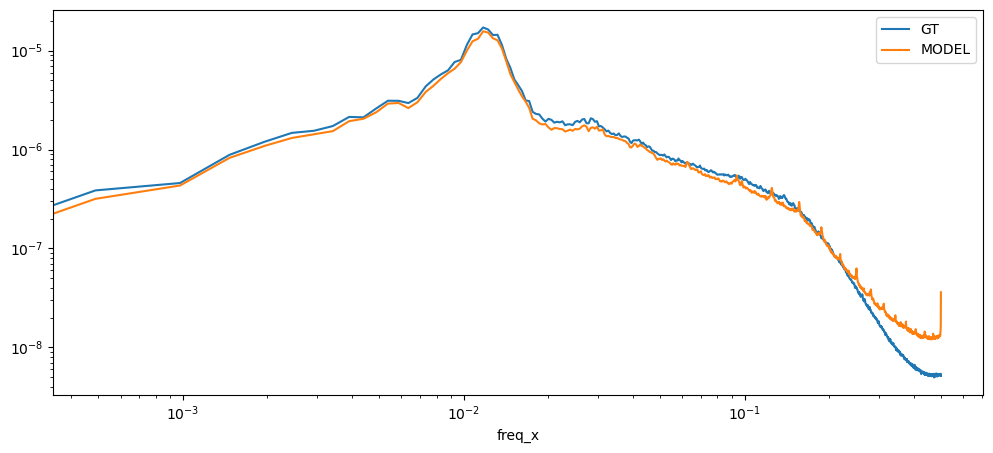

In [22]:
fig, ax = plt.subplots(figsize=(12, 5))

(ps_its * ps_its.freq_x).mean(['z', 'y']).plot(label='GT', ax=ax)
(ps_gits * ps_gits.freq_x).mean(['z', 'y']).plot(label='MODEL', ax=ax)

ax.set_xscale('log')
ax.set_yscale('log')

plt.legend()
plt.show()

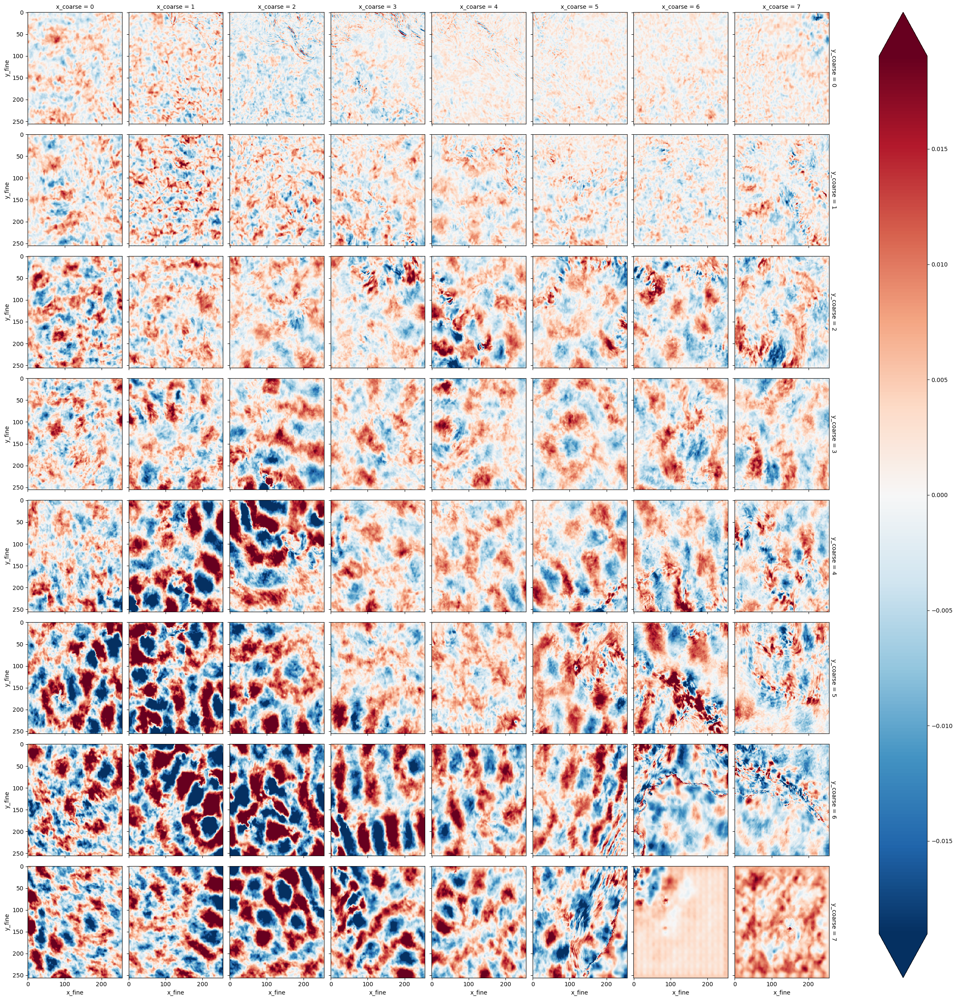

In [23]:
arr = gens[0]
arr = arr.reshape(8, 8, 256, 256) # (8, 8, 256, 256)
arr = arr.transpose(0, 2, 1, 3)   # (8, 256, 8, 256) 

xr.DataArray(arr, dims=['x_coarse', 'x_fine', 'y_coarse', 'y_fine']).plot(x='x_fine', y='y_fine', col='x_coarse', row='y_coarse', robust=True, yincrease=False)
plt.show()

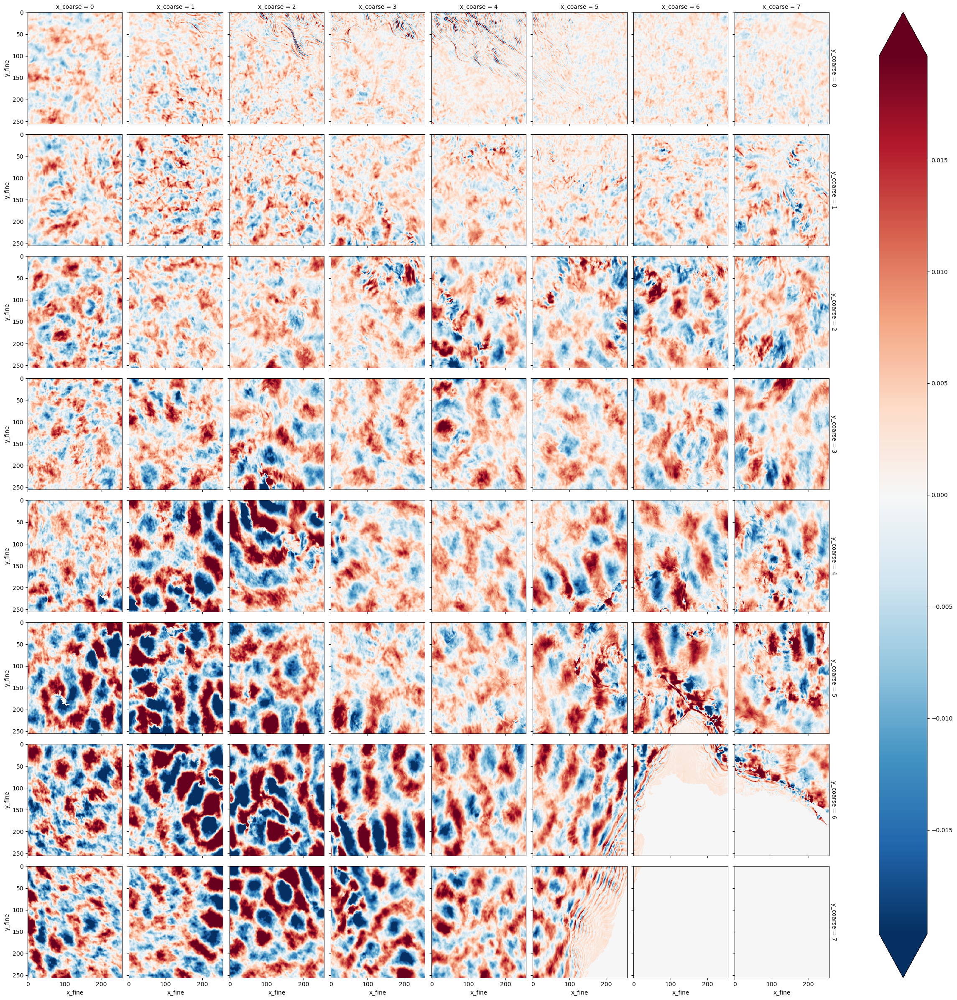

In [24]:
# Fully vectorized approach:

arr = it.values[0] # (2048, 2048)
arr = arr.reshape(8, 256, 8, 256) # (8, 256, 8, 256)

xr.DataArray(arr, dims=['x_coarse', 'x_fine', 'y_coarse', 'y_fine']).plot(x='x_fine', y='y_fine', col='x_coarse', row='y_coarse', robust=True, yincrease=False)
plt.show()

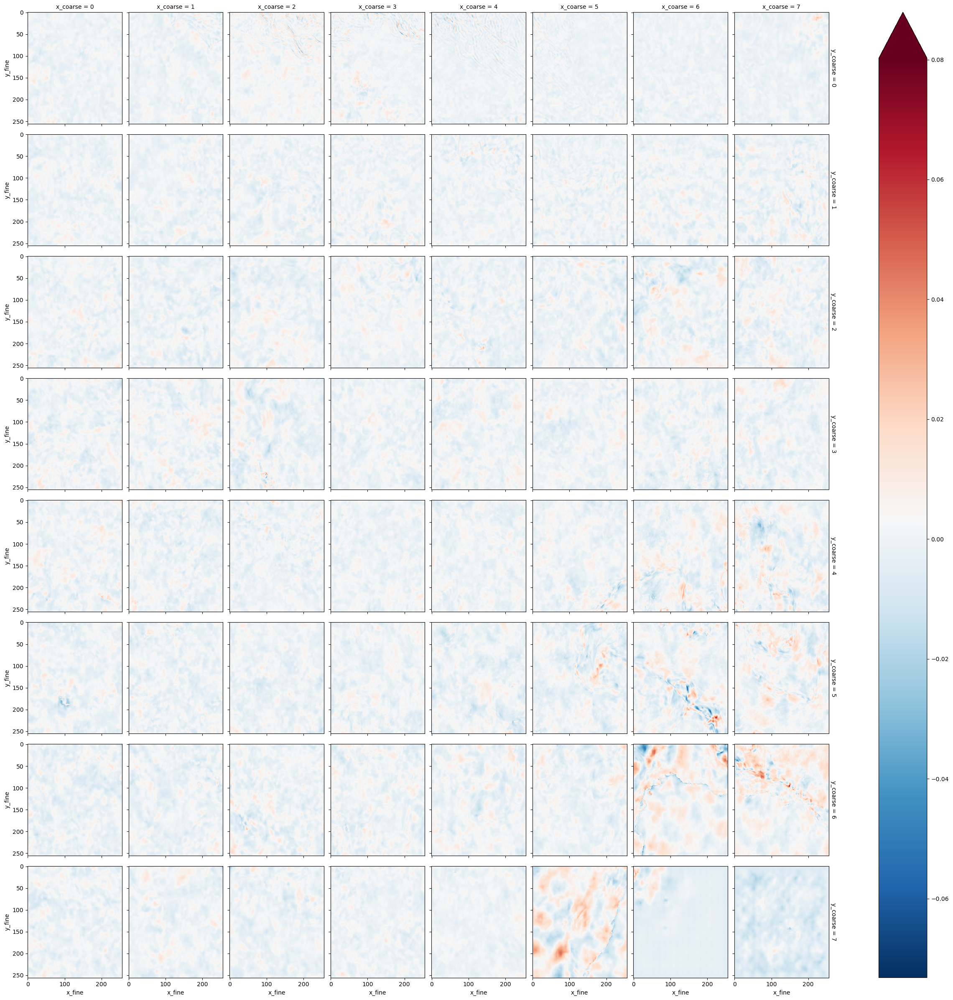

In [29]:
arr1 = gens[0] # (64, 256, 256)
arr1 = arr1.reshape(8, 8, 256, 256) # (8, 8, 256, 256)
arr1 = arr1.transpose(0, 2, 1, 3)   # (8, 256, 8, 256)

arr2 = it.values[0] # (2048, 2048)
arr2 = arr2.reshape(8, 256, 8, 256) # (8, 256, 8, 256)

arr3 = arr2 - arr1

vmin = arr2.min(); vmax = arr2.max()
xr.DataArray(arr3, dims=['x_coarse', 'x_fine', 'y_coarse', 'y_fine']).plot(x='x_fine', y='y_fine', col='x_coarse', row='y_coarse', vmax=vmax, vmin=vmin, robust=True, yincrease=False, cmap='RdBu_r')
plt.show()

In [22]:
def f(output_size, ksize, stride):
    return (output_size - 1) * stride + ksize

last_layer = f(output_size=1, ksize=4, stride=1)
# Receptive field: 4

fourth_layer = f(output_size=last_layer, ksize=4, stride=1)
# Receptive field: 7

third_layer = f(output_size=fourth_layer, ksize=4, stride=2)
# Receptive field: 16

second_layer = f(output_size=third_layer, ksize=4, stride=2)
# Receptive field: 34

first_layer = f(output_size=second_layer, ksize=4, stride=2)
# Receptive field: 70

print(first_layer)

70
